$\def\m#1{\mathbf{#1}}$
$\def\mm#1{\boldsymbol{#1}}$
$\def\mb#1{\mathbb{#1}}$
$\def\c#1{\mathcal{#1}}$
$\def\mr#1{\mathrm{#1}}$
$\newenvironment{rmat}{\left[\begin{array}{rrrrrrrrrrrrr}}{\end{array}\right]}$
$\newcommand\brm{\begin{rmat}}$
$\newcommand\erm{\end{rmat}}$
$\newenvironment{cmat}{\left[\begin{array}{ccccccccc}}{\end{array}\right]}$
$\newcommand\bcm{\begin{cmat}}$
$\newcommand\ecm{\end{cmat}}$

# Homework 1
## Homework guideline
- The deadline is Feb 2nd 10:30am. Submission after the deadline will not be graded.

- Submit your work(your reasoning and your code) as a SINGLE .ipynb document. Please rename the document as _HW1_YOURNAME.ipynb_ (for example, _HW1_FELIX.ipynb_). You are responsible for checking that you have correctly submitted the correct document. If your code cannot run, you may receive NO point.

- Please justify all short answers with a brief explanation.

- You only use the Python packages included in the following cell. You are not allowed to use other advanced package or modules unless you are permitted to.

- In your final submission include the plots produced by the unedited code as presented below, as well as any additional plots produced after editing the code during the course of a problem. You may find it necessary to copy/paste relevant code into additional cells to accomplish this.

- Feel free to use the lecture notes and other resources. But you
must understand, write, and hand in your own answers. In addition, you must write and submit
your own code in the programming part of the assignment (we may run your code).
If you copy someone else homework solution, both of you may receive ZERO point.


- **You must write your own code and fill in the your answer in the text box.** If you fail to do either of that, you will receive zero point.

- **If you copy and paste the code from chatGPT, Bard or etc, you will receive zero point**.

In [ ]:
import pandas as pd
import numpy as np

import seaborn as sns

sns.set()
import matplotlib.pyplot as plt

# sharper plots
%config InlineBackend.figure_format = 'retina'



---



---

# Q1: Data Analysis of US Flight
For this question, the dataset is very large(~1G) so we need to use the google drive to store the data. You need to allow the colab access your google drive. If you feel unsafe to your own personal data, you can create a new google account, simply for the purpose of data analysis.

**Data Description:** The dataset has information about carriers and flights between US airports during the year 2008.
Column description is available [here](https://www.transtats.bts.gov/Fields.asp?gnoyr_VQ=FGJ). Visit this site to find ex. meaning of flight cancellation codes.

Consider the following terms we use:
* unique flight – a record (row) in the dataset
* completed flight – flight that is not cancelled (Cancelled==0 in the dataset)
* flight code – a combination of ['UniqueCarrier','FlightNum'], i.e.  UA52
* airport code – a three letter airport alias from 'Origin or 'Dest' columns

**Data access:** the data is stored in https://drive.google.com/file/d/1kOEcWtcTbbrlhVf1wlYtFQUF_kY92U5O/.

**Load Data:** Once you open the link in the brower, make sure you click the "Add shortcut to Drive" and now your google drive should show up the zip file.  Then you run the following code to link colab to your google drive.




In [ ]:
from google.colab import drive
drive.mount('/content/drive')
import os
os.chdir("/content/drive/My Drive/intern")


Mounted at /content/drive


We are not going to read in the whole dataset. In order to reduce memory footprint, we instead load only needed columns and cast them to suitable data types.

In [ ]:
dtype = {
    "DayOfWeek": np.uint8,
    "DayofMonth": np.uint8,
    "Month": np.uint8,
    "Cancelled": np.uint8,
    "Year": np.uint16,
    "FlightNum": np.uint16,
    "Distance": np.uint16,
    "UniqueCarrier": str,
    "CancellationCode": str,
    "Origin": str,
    "Dest": str,
    "ArrDelay": np.float16,
    "DepDelay": np.float16,
    "CarrierDelay": np.float16,
    "WeatherDelay": np.float16,
    "NASDelay": np.float16,
    "SecurityDelay": np.float16,
    "LateAircraftDelay": np.float16,
    "DepTime": np.float16,
}
flights_df = pd.read_csv("flights_2008.csv.bz2", usecols=dtype.keys(), dtype=dtype)

In [ ]:
print(flights_df.shape)
print(flights_df.columns)

(7009728, 19)
Index(['Year', 'Month', 'DayofMonth', 'DayOfWeek', 'DepTime', 'UniqueCarrier',
       'FlightNum', 'ArrDelay', 'DepDelay', 'Origin', 'Dest', 'Distance',
       'Cancelled', 'CancellationCode', 'CarrierDelay', 'WeatherDelay',
       'NASDelay', 'SecurityDelay', 'LateAircraftDelay'],
      dtype='object')


In [ ]:
# Print first 5 rows of the dataset
flights_df.head()

,Year,Month,DayofMonth,DayOfWeek,DepTime,UniqueCarrier,FlightNum,ArrDelay,DepDelay,Origin,Dest,Distance,Cancelled,CancellationCode,CarrierDelay,WeatherDelay,NASDelay,SecurityDelay,LateAircraftDelay
0,2008,1,3,4,2003.0,WN,335,-14.0,8.0,IAD,TPA,810,0,NaN,NaN,NaN,NaN,NaN,NaN
1,2008,1,3,4,754.0,WN,3231,2.0,19.0,IAD,TPA,810,0,NaN,NaN,NaN,NaN,NaN,NaN
2,2008,1,3,4,628.0,WN,448,14.0,8.0,IND,BWI,515,0,NaN,NaN,NaN,NaN,NaN,NaN
3,2008,1,3,4,926.0,WN,1746,-6.0,-4.0,IND,BWI,515,0,NaN,NaN,NaN,NaN,NaN,NaN
4,2008,1,3,4,1829.0,WN,3920,34.0,34.0,IND,BWI,515,0,NaN,2.0,0.0,0.0,0.0,32.0


In [ ]:
# Examine data types of all features and total dataframe size in memory
flights_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7009728 entries, 0 to 7009727
Data columns (total 19 columns):
 #   Column             Dtype  
---  ------             -----  
 0   Year               uint16 
 1   Month              uint8  
 2   DayofMonth         uint8  
 3   DayOfWeek          uint8  
 4   DepTime            float16
 5   UniqueCarrier      object 
 6   FlightNum          uint16 
 7   ArrDelay           float16
 8   DepDelay           float16
 9   Origin             object 
 10  Dest               object 
 11  Distance           uint16 
 12  Cancelled          uint8  
 13  CancellationCode   object 
 14  CarrierDelay       float16
 15  WeatherDelay       float16
 16  NASDelay           float16
 17  SecurityDelay      float16
 18  LateAircraftDelay  float16
dtypes: float16(8), object(4), uint16(3), uint8(4)
memory usage: 387.7+ MB





Here are simples tasks to further understand this dataset first.




---



---



## Q1.1

Count unique Carriers and plot their relative share of flights

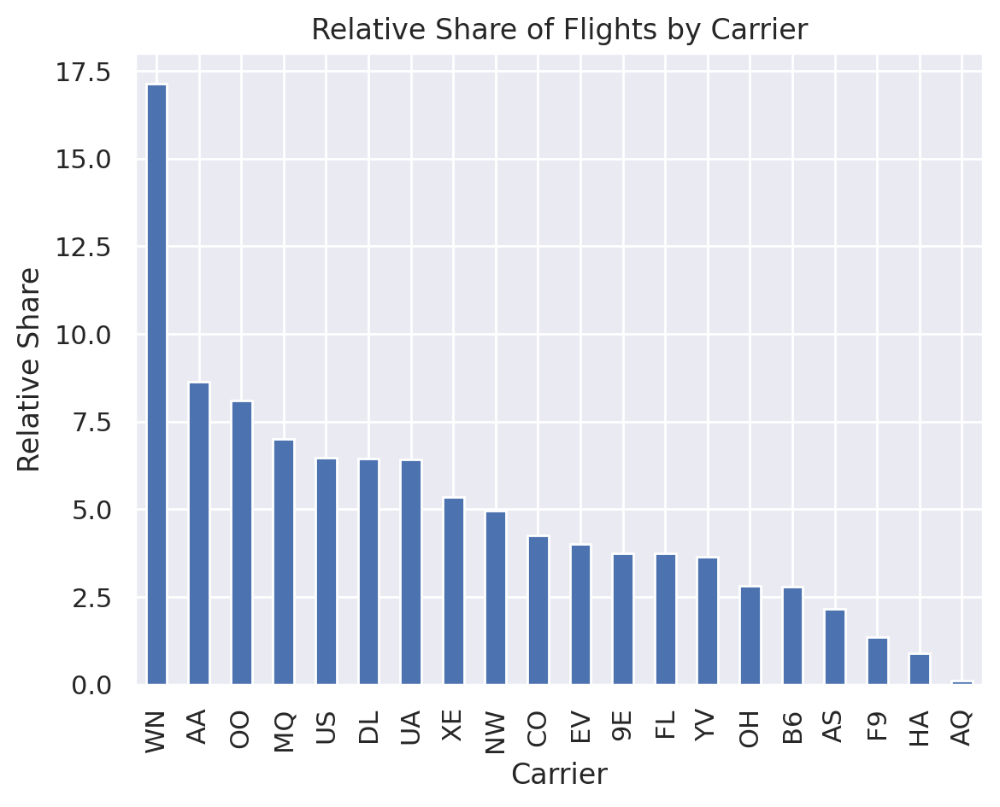

In [ ]:
carrier_counts = flights_df['UniqueCarrier'].value_counts()
total_flights = len(flights_df)

relative_share = (carrier_counts / total_flights) * 100
relative_share.plot(kind='bar')
plt.title('Relative Share of Flights by Carrier')
plt.xlabel('Carrier')
plt.ylabel('Relative Share')
plt.show()

### Your Answer to Q1.1:

It can be seen that Carrier WN has the highest share of flights approx. 17.3% followed by AA 8.5% and AQ being the lowest at 0.2%.



---


## Q1.2

Finding top-3 flight codes, that have the largest total distance traveled in year 2008



In [ ]:
flights_2008 = flights_df[flights_df['Year'] == 2008]
top_flight_codes_2008 = flights_2008.groupby(['UniqueCarrier', 'FlightNum'])['Distance'].sum().sort_values(ascending=False).head(3)
top_flight_codes_2008

UniqueCarrier  FlightNum
CO             15           1796244
               14           1796244
UA             52           1789722
Name: Distance, dtype: uint64

### Your Answer to Q1.2:

1. The total distance travelled by the carrier with code 'CO' and flight number '14' is 1796244.
2. The total distance travelled for the same carrier, CO, but with flight number, 15 is 1796244.
3. The total distance travelled by the airline with code 'UA' and flight number '52' is 1789722.




---


## Q1.3

Find number of flights by days of week and months and use imshow to plot this table



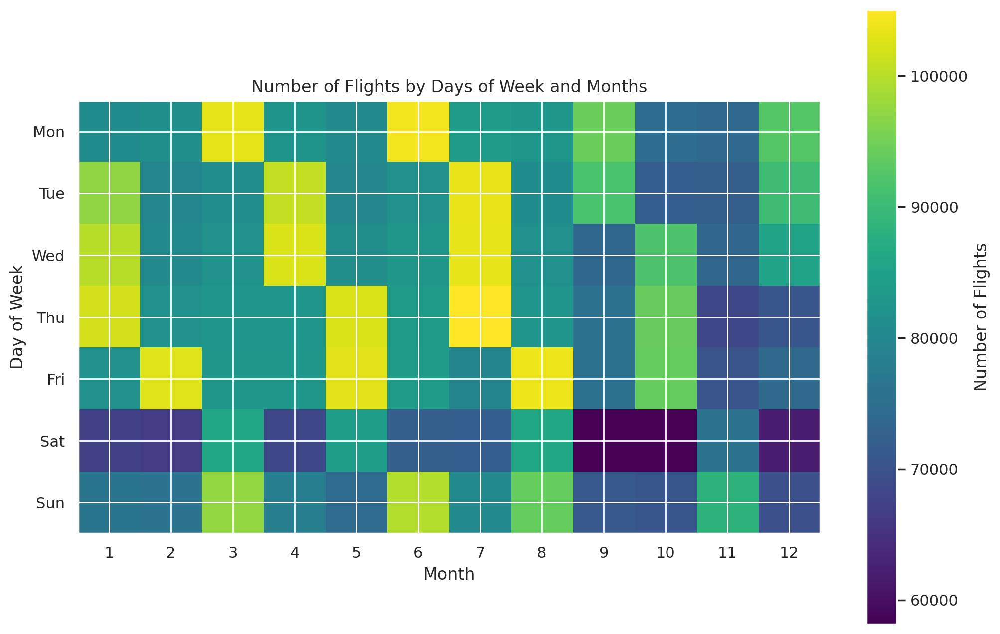

In [ ]:
flights_by_day_month = flights_df.pivot_table(index='DayOfWeek', columns='Month', values='FlightNum', aggfunc='count')

plt.figure(figsize=(12, 8))
plt.imshow(flights_by_day_month, cmap='viridis', interpolation='nearest')
plt.colorbar(label='Number of Flights')
plt.xticks(np.arange(12), range(1, 13))
plt.yticks(np.arange(7), ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'])
plt.xlabel('Month')
plt.ylabel('Day of Week')
plt.title('Number of Flights by Days of Week and Months')
plt.show()

### Your Answer to Q1.3:
The months till July mostly during weekdays specially on Tuesday,Wednesday, Thrusday and Friday has the highest number of flights and Mondays of March and June also has a huge traffic of flights.
Lowest are mostly on Saturdays starting september through December, but overall winter months has low number of flights i.e; Due to weather conditions.



---

## Q1.4

We have both cancelled and completed flights in the dataset.
Check if there are more completed or cancelled flights. What is the difference?

In [ ]:
l = []
l = flights_df['Cancelled'].value_counts().values
print("Completed Flights = ",l[0])
print("Cancelled Flights = ",l[1])
print("Difference =",l[0]-l[1])

Completed Flights =  6872294
Cancelled Flights =  137434
Difference = 6734860


### Your Answer to Q1.4:
Completed Flights: 6,872,294
Flights Cancelled: 137,434
6,734,860 is the difference (Completed - Cancelled).
There are 6,734,860 more completed flights than cancelled flights.



---

## Q1.5
Find the carrier that has the greatest number of cancelled flights.



In [ ]:
cancelled_flights_data = flights_df[flights_df['Cancelled'] == 1]
cancelled_flights_carrier = cancelled_flights_data['UniqueCarrier'].value_counts()
cancelled_flights_carrier.head(1)

MQ    18331
Name: UniqueCarrier, dtype: int64

### Your Answer to Q1.5:

MQ has 18331 number of cancelled, i.e. the highest number of cancelled flights.



---
## Q1.6
 1. Plot distributions of flight cancellation reasons (CancellationCode).
 2. What is the most frequent reason for flight cancellation?

 (Use this (https://www.transtats.bts.gov/Fields.asp?Table_ID=236) to translate codes into reasons)



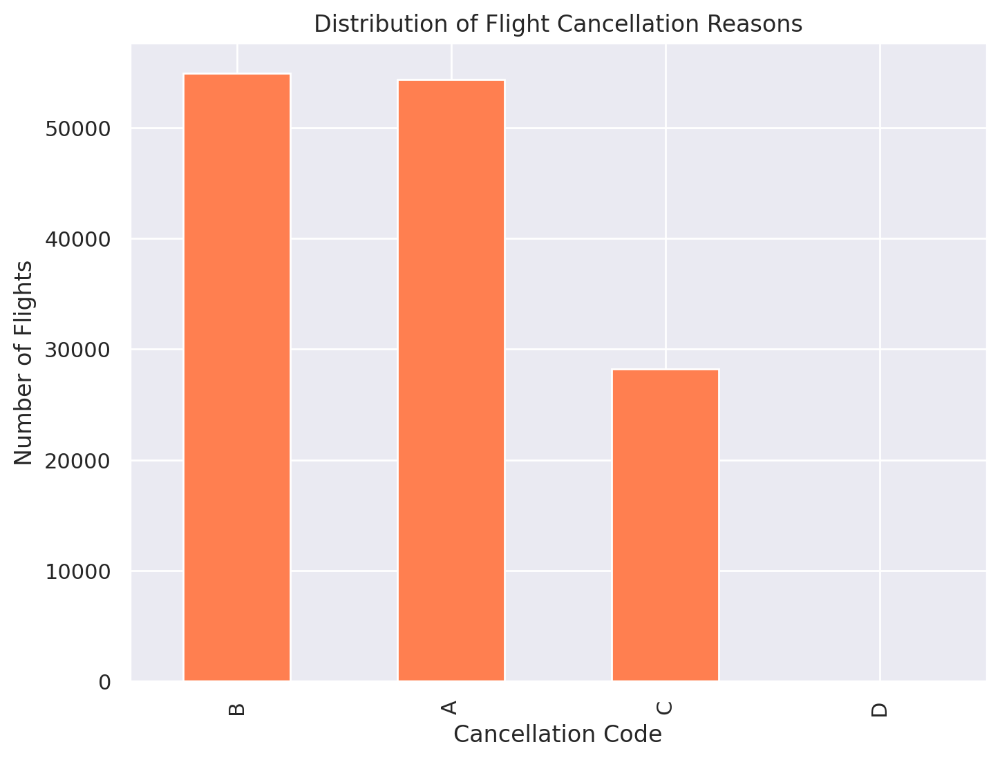

In [ ]:
CancellationCode_df = flights_df['CancellationCode'].value_counts()


plt.figure(figsize=(8, 6))
CancellationCode_df.plot(kind='bar', color='coral')
plt.title('Distribution of Flight Cancellation Reasons')
plt.xlabel('Cancellation Code')
plt.ylabel('Number of Flights')
plt.show()


### Your Answer to Q1.6:
A-Carrier Caused
B-Weather
C-National Aviation System
D-Security

The most frequent reason for flight cancellation is B:Weather. That we could also see in heat map that during the winters the number of flights are comparitively fewer.



---


## Q1.7
 We'll need a new column in our dataset - departure hour
 `DepTime` is distributed from 1 to 2400 (it is given in the `hhmm` format.
 We'll treat departure hour as `DepTime` // 100 (divide by 100 and apply the `floor` function).
 However, now we'll have both hour 0 and hour 24.
 Hour 24 sounds strange, we'll set it to be 0 instead (a typical imperfectness of real data, however, you can check that it affects only 521 rows, which is sort of not a big deal).
 So now values of a new column `DepHour` will be distributed from 0 to 23.
 There are some missing values, for now we won't fill in them, just ignore them.


In [ ]:
flights_df['DepHour'] = flights_df['DepTime'] // 100
flights_df['DepHour'].replace(24, 0, inplace=True)
flights_df['DepHour'].value_counts()

8.0     449224
6.0     446737
11.0    444702
7.0     436700
13.0    435917
9.0     434850
16.0    434017
17.0    432488
10.0    431460
12.0    424249
14.0    416875
15.0    411126
18.0    400784
19.0    387288
20.0    285991
21.0    254850
5.0     148167
22.0    119651
23.0     46103
0.0      20368
1.0       5861
4.0       3390
2.0       1851
3.0        833
Name: DepHour, dtype: int64

### Your Answer to Q1.7:

We can easily conclude that after 11pm till 4am there are less number of flights.



---
## Q1.8:
 Which route is the most frequent, in terms of the number of flights?
 Take a look at 'Origin' and 'Dest' features. Consider A->B and B->A directions as different routes)


In [ ]:
flights_df['Route'] = flights_df['Origin'] + '-' + flights_df['Dest']
most_frequent_route = flights_df['Route'].value_counts().idxmax()
most_frequent_route, flights_df['Route'].value_counts().max()

('SFO-LAX', 13788)

### Your Answer to Q1.8:
 ('SFO->LAX', 13788) is the most frequent route with the distance 13,788.



---
## Q1.9:
1. Find top-5 delayed routes (count how many times they were delayed on departure).
2. From all flights on these 5 routes, count all flights with weather conditions contributing to a delay.
Consider only positive delays.


In [ ]:
delayed_route_counts = flights_df[flights_df['DepDelay'] > 0].groupby(['Origin', 'Dest']).size().reset_index(name='Delayed_Departures')
top_5_routes = delayed_route_counts.nlargest(5, 'Delayed_Departures')[['Origin', 'Dest']]
print("Top 5 Delayed Routes:")
print(top_5_routes)

flights_w_top_5_routes = flights_df.merge(top_5_routes, on=['Origin', 'Dest'], how='inner')
flights_w_weather_delay = flights_w_top_5_routes[flights_w_top_5_routes['WeatherDelay'] > 0]
weather_delays = len(flights_w_weather_delay)
print("Flights with Weather Delays on Top 5 Routes:", weather_delays)


Top 5 Delayed Routes:
     Origin Dest
2722    LAX  SFO
1179    DAL  HOU
4636    SFO  LAX
3775    ORD  LGA
2080    HOU  DAL
Flights with Weather Delays on Top 5 Routes: 668


### Your Answer to Q1.9:
4636 times flight from SFO-LAX has been delayed on departure. Followed by route ORD-LGA.
There are 668 weather delays on the top 5 routes.




---

## Q1.10:
Let's examine departure time and consider distribution by hour (column `DepHour` that we've created earlier).
1. Which hour has the highest percentage of flights?
2. Which hour has the least percentage of cancelled flights?


In [ ]:
count_flights_by_hr = flights_df['DepHour'].value_counts().sort_index()
total_flights = count_flights_by_hr.sum()
percentage_flights_by_hr = (count_flights_by_hr / total_flights) * 100
hr_with_highest_percentage = percentage_flights_by_hr.idxmax()
highest_percentage = percentage_flights_by_hr.max()
print(hr_with_highest_percentage,"hr" ,round(highest_percentage,2),"%")

cancelled_flights_by_hr = flights_df[flights_df['Cancelled'] == 1]['DepHour'].value_counts().sort_index()
percentage_cancelled_by_hr = (cancelled_flights_by_hr / count_flights_by_hr) * 100
hour_with_least_cancelled_percentage = percentage_cancelled_by_hr.idxmin()
least_cancelled_percentage = percentage_cancelled_by_hr.min()
print(hour_with_least_cancelled_percentage,"hr",round(least_cancelled_percentage,2),"%")


8.0 hr 6.54 %
13.0 hr 0.01 %


### Your Answers to Q1.10

8am has the highest number of flights by 6.5%
and 1pm has the lowest number of cancelled flight i.e. almost 0%.



---


## Q1.11
Since we know the departure hour, it might be interesting to examine the average delay for corresponding hour.
1. Are there any cases, when the planes on average departed earlier than they should have done?
2. And if yes, at what departure hours did it happen?


In [ ]:
average_delay_by_hour = flights_df.groupby('DepHour')['DepDelay'].mean()
print(average_delay_by_hour)

early_departed_hrs = average_delay_by_hour[average_delay_by_hour < 0]
if len(early_departed_hrs) > 0:
    print("departure hours with planes departing earlier than scheduled",np.array(early_departed_hrs.index))
else:
    print("no planes departing earlier than scheduled")

DepHour
0.0      70.784470
1.0     111.969627
2.0     122.731499
3.0      95.819931
4.0       3.370502
5.0      -4.255138
6.0      -1.628840
7.0       0.103684
8.0       1.762197
9.0       3.754863
10.0      5.466344
11.0      6.685565
12.0      7.903552
13.0      8.815181
14.0     10.355634
15.0     11.887509
16.0     11.890170
17.0     13.221905
18.0     15.349507
19.0     16.887009
20.0     22.795918
21.0     23.048708
22.0     38.054039
23.0     60.066807
Name: DepDelay, dtype: float32
departure hours with planes departing earlier than scheduled [5. 6.]


### Your Answers to Q1.11

At 5 and 6am the planes have departed earlier than scheduled.



---

## Q1.12
Examine the distribution of cancellation reasons with time. Make a bar plot of cancellation reasons aggregated by months.



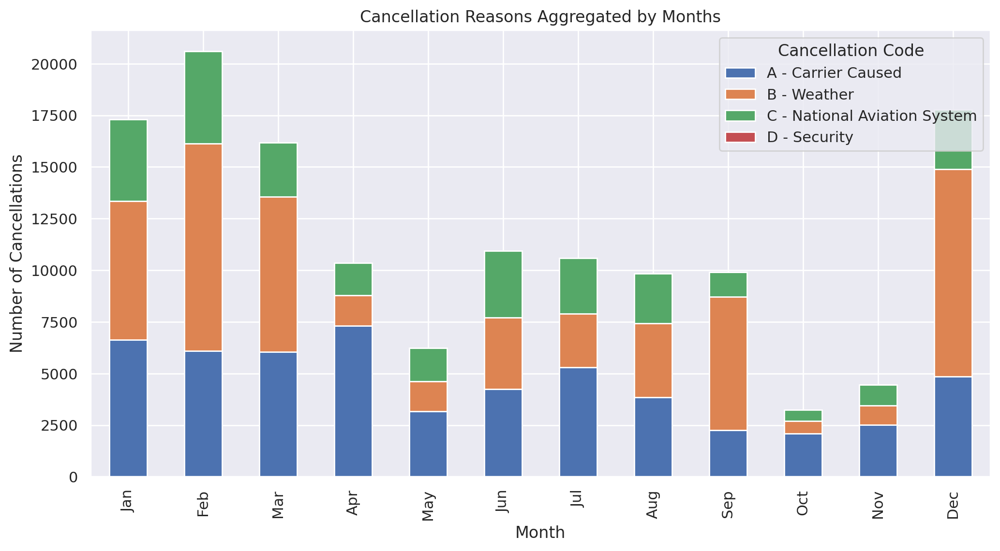

In [ ]:
import calendar

cancellation_counts = flights_df.groupby(['Month', 'CancellationCode']).size().unstack(fill_value=0)
cancellation_counts.plot(kind='bar', stacked=True, figsize=(12, 6))
plt.title('Cancellation Reasons Aggregated by Months')
plt.xlabel('Month')
plt.ylabel('Number of Cancellations')
plt.legend(title='Cancellation Code', loc='upper right',labels=['A - Carrier Caused', 'B - Weather', 'C - National Aviation System', 'D - Security'])
plt.xticks(range(12), [calendar.month_abbr[i] for i in range(1, 13)])
plt.show()


### Your Answers to Q1.12
February has the highest number of cancelled flights, weather being the top most reason from December to March and September. And Carrier caused cancellation running from April having the highest cancellation till November.



---


## Q1.13
Examine median arrival and departure delays (in time) by carrier.

1. Which carrier has the lowest median delay time for both arrivals and departures? Leave only non-negative values of delay times ('ArrDelay', 'DepDelay').
2. Use ([Boxplots](https://seaborn.pydata.org/generated/seaborn.boxplot.html) to plot ArrDelay vs Carrier and DepDelay vs Carrier.



The carrier with the lowest median delay time for both arrivals and departures AQ


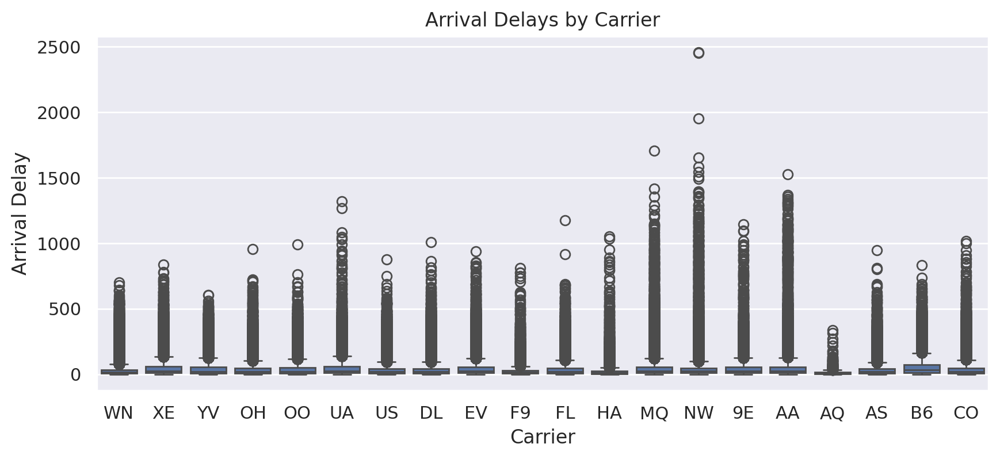

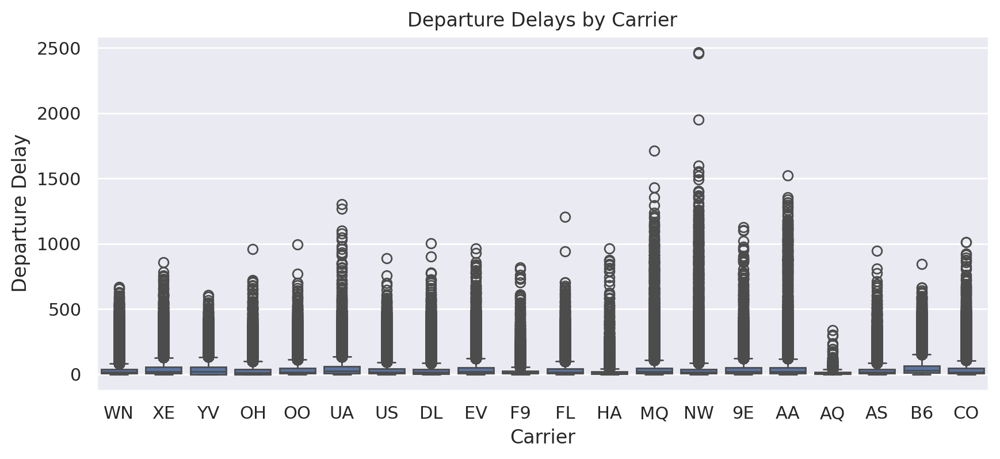

In [ ]:
flights_df = flights_df[(flights_df['ArrDelay'] >= 0) & (flights_df['DepDelay'] >= 0)]
median_delays = flights_df.groupby('UniqueCarrier')[['ArrDelay', 'DepDelay']].median()
lowest_median_delay_carrier = median_delays.sum(axis=1).idxmin()
print("The carrier with the lowest median delay time for both arrivals and departures", lowest_median_delay_carrier)

plt.figure(figsize=(10, 4))
sns.boxplot(data=flights_df, x='UniqueCarrier', y='ArrDelay')
plt.title('Arrival Delays by Carrier')
plt.xlabel('Carrier')
plt.ylabel('Arrival Delay')
plt.show()
plt.figure(figsize=(10, 4))
sns.boxplot(data=flights_df, x='UniqueCarrier', y='DepDelay')
plt.title('Departure Delays by Carrier')
plt.xlabel('Carrier')
plt.ylabel('Departure Delay')
plt.show()



### Your Answers to Q1.13

Carrier AQ has the lowest median delay time for both arrivals and departures followed by YV and NW has the highest delay arrivals and departures.

# Q2: Video Sale

We picked a dataset on video game sales and ratings from [Video Game Sales with Ratings](https://www.kaggle.com/datasets/rush4ratio/video-game-sales-with-ratings). Some of the games in this dataset lack ratings; so, let’s filter for only those examples that have all of their values present.



In [ ]:
!wget https://raw.githubusercontent.com/yexf308/PracticalML/main/data/video_games_sales.csv?raw=true -O video_games_sales.csv


--2024-02-01 22:11:47--  https://raw.githubusercontent.com/yexf308/PracticalML/main/data/video_games_sales.csv?raw=true
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1618040 (1.5M) [text/plain]
Saving to: ‘video_games_sales.csv’

video_games_sales.c 100%[===================>]   1.54M  --.-KB/s    in 0.05s   

2024-02-01 22:11:47 (28.6 MB/s) - ‘video_games_sales.csv’ saved [1618040/1618040]



In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

sns.set()

# Graphics in SVG format are more sharp and legible
%config InlineBackend.figure_format = 'svg'

# Increase the default plot size and set the color scheme
plt.rcParams["figure.figsize"] = (8, 5)
plt.rcParams["image.cmap"] = "viridis"

In [ ]:
# Load the data into a pandas dataframe and droped NA data entry
df = pd.read_csv("video_games_sales.csv").dropna()
print(df.shape)

(6825, 16)


In [ ]:
# Next, print the summary of the DataFrame to check data types and to verify everything is non-null.
print(df.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6825 entries, 0 to 16706
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Name             6825 non-null   object 
 1   Platform         6825 non-null   object 
 2   Year_of_Release  6825 non-null   float64
 3   Genre            6825 non-null   object 
 4   Publisher        6825 non-null   object 
 5   NA_Sales         6825 non-null   float64
 6   EU_Sales         6825 non-null   float64
 7   JP_Sales         6825 non-null   float64
 8   Other_Sales      6825 non-null   float64
 9   Global_Sales     6825 non-null   float64
 10  Critic_Score     6825 non-null   float64
 11  Critic_Count     6825 non-null   float64
 12  User_Score       6825 non-null   object 
 13  User_Count       6825 non-null   float64
 14  Developer        6825 non-null   object 
 15  Rating           6825 non-null   object 
dtypes: float64(9), object(7)
memory usage: 906.4+ KB
None


In [ ]:
df["User_Count"]

0        322.0
2        709.0
3        192.0
6        431.0
7        129.0
         ...  
16667     21.0
16677      9.0
16696    412.0
16700     43.0
16706     13.0
Name: User_Count, Length: 6825, dtype: float64

In [ ]:
df["Critic_Score"]

0        76.0
2        82.0
3        80.0
6        89.0
7        58.0
         ... 
16667    46.0
16677    81.0
16696    80.0
16700    61.0
16706    60.0
Name: Critic_Score, Length: 6825, dtype: float64

## Q2.1
We see that pandas has loaded some of the numerical features as object type.
1. What are these features?

2. We will explicitly convert those columns into float and int.

In [ ]:
df["User_Score"] = pd.to_numeric(df["User_Score"], errors='coerce')
df["Rating"] = df["Rating"].astype("category")
#df["Developer"] = df["Developer"].astype("category")
df["Platform"] = df["Platform"].astype("category")
df["Genre"] = df["Genre"].astype("category")
df["Year_of_Release"] = df["Year_of_Release"].astype(int)
df["User_Count"] = df["User_Count"].astype(int)
print(df.dtypes)

Name                 object
Platform           category
Year_of_Release       int64
Genre              category
Publisher            object
NA_Sales            float64
EU_Sales            float64
JP_Sales            float64
Other_Sales         float64
Global_Sales        float64
Critic_Score        float64
Critic_Count        float64
User_Score          float64
User_Count            int64
Developer            object
Rating             category
dtype: object


### Your Answer to Q2.1:
User_Score:  This column contains numerical values but is loaded as an object type so converted as float. And replaced non-numeric values in 'User_Score' with NaN.

User_Count, Year_of_Release: These column contains numerical values but is loaded as an object type.

Rating, Genre, Platform: This column contains categorical values related to video game rating, genre and platforms.








---
## Q2.2
1. Create a plot of video game sales by country and year.
2. What can you tell from the plot?


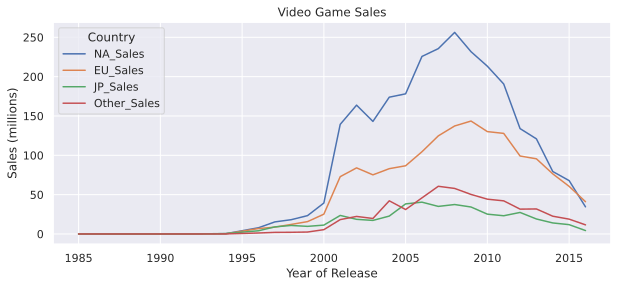

In [ ]:
sales_by_year_country = df.groupby('Year_of_Release')[['NA_Sales', 'EU_Sales', 'JP_Sales', 'Other_Sales']].sum().reset_index()
plt.figure(figsize=(10, 4))
sns.lineplot(x='Year_of_Release', y='value', hue='variable', data=pd.melt(sales_by_year_country, ['Year_of_Release']))
plt.title('Video Game Sales')
plt.xlabel('Year of Release')
plt.ylabel('Sales (millions)')
plt.legend(title='Country', loc='upper left')
plt.show()


### Your answer to Q2.2:
NA(North-America) Sales has been at the top amongst the other countries touching the peak around 2008 for almost 256.25 million and at the bottom JP sales having the highest sales near 2006 at almost 40 million. The video game sales started their growth in sales from 1995 and has been declining since 2010 tremendously in NA and EU countries. The other counties sales has a steady decline averaging overall sales near 25-40 million from 2015.



---
## Q2.3
1. Create a pairwise relationships plot for `Global_Sales`, `Critic_Score`, `Critic_Count`, `User_Score`, `User_Count`.

2. What can you tell from the plot?



In [ ]:
pair_columns = ['Global_Sales', 'Critic_Score', 'Critic_Count', 'User_Score', 'User_Count']
sns.pairplot(df[pair_columns])
plt.show()

### Your answer to Q2.3:
A positive correlation between Critic_Score and User_Score shows a broad consensus between critics and users having same game preference.

Global Sales: There exist a correlation exists between Global_Sales and both Critic_Score and User_Score suggesting that games with elevated scores have higher sales. However, it might not be the case for every good scoring game. The counts are not significate in the sales on individual level.

Critic Patterns: Critic_Score and Critic_Count shows a trend that with high views there are chances of getting good scores, implying that games subject to more reviews subject to good content indicating global sales.

User Patterns: User and User_Count display similar trend as critic, indicating that with wider audience the chances of having more good rating amongst the viewers contributiong to global sales.





---

## Q2.4
1. Plot a distribution of observations critics’ ratings.

2. Perform some statistical analysis on the feature. What can you tell from it?


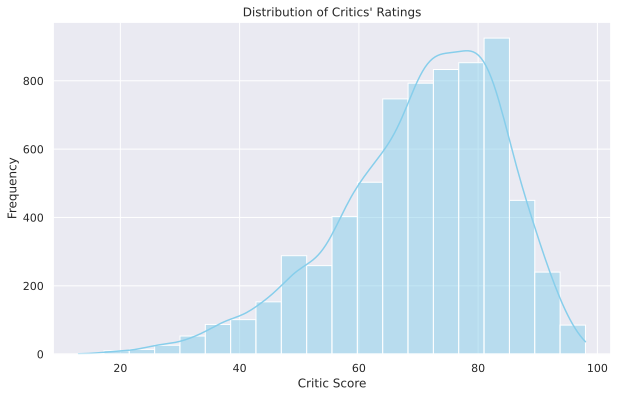

Mean Critic Score: 70.27
Median Critic Score: 72.00
Standard Deviation: 13.87
Skewness: -0.75


In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(df['Critic_Score'], bins=20, kde=True, color='skyblue')
plt.title('Distribution of Critics\' Ratings')
plt.xlabel('Critic Score')
plt.ylabel('Frequency')
plt.show()
#stats
mean_critic_score = df['Critic_Score'].mean()
median_critic_score = df['Critic_Score'].median()
std_dev_critic_score = df['Critic_Score'].std()
skewness_critic_score = df['Critic_Score'].skew()

print(f"Mean Critic Score: {mean_critic_score:.2f}")
print(f"Median Critic Score: {median_critic_score:.2f}")
print(f"Standard Deviation: {std_dev_critic_score:.2f}")
print(f"Skewness: {skewness_critic_score:.2f}")



### Your answer to Q2.4:
The mean and median being close suggests a relatively symmetric distribution implying the average rating ~ 70 for video games but the negative skewness indicates a slight left skew as seen in the graph indicating a negative skew where a majority of games receive ratings above the average.
The standard deviation of 13.87 shows moderate variability in critic scores implies that, while there is some unity among critics there exists a dispute in their critics scoring.







---

## Q2.5:
To look more closely at the relationship between two numerical variables,

1. use jointplot to see how the `Critic_Score` and `User_Score` features are related.

2. What can you tell from it?

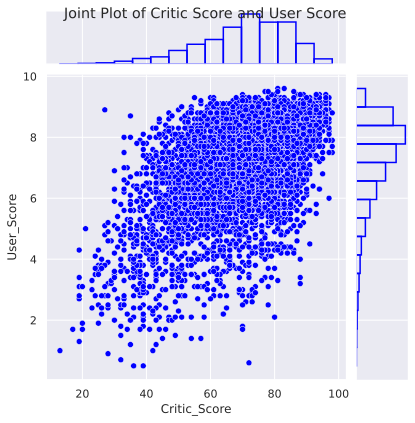

In [ ]:
sns.jointplot(x='Critic_Score', y='User_Score', data=df, kind='scatter', color='blue', marginal_kws=dict(bins=15, fill=False))
plt.suptitle('Joint Plot of Critic Score and User Score')
plt.show()

### Your answer to Q2.5:
There is some positive correlation is observed between Critic_Score and User_Score. This indicates that if on average, as Critic_Score rises there is a tendency for User_Score to also increase, although exactly in linear manner.

While the correlation is not highly robust, evidenced by some scattering of points, a discernible trend emerges. Critic_scores are widely spead across, while the user_scores are more concentrated within the middle range, with fewer outliers.



---


## Q2.6
1. Use Boxplot compare critics’ ratings for the top 5 biggest gaming platforms.
2. What can you tell from it?



<ipython-input-78-9a62128d4903>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Platform', y='Critic_Score', data=df_top_platforms, palette='viridis')


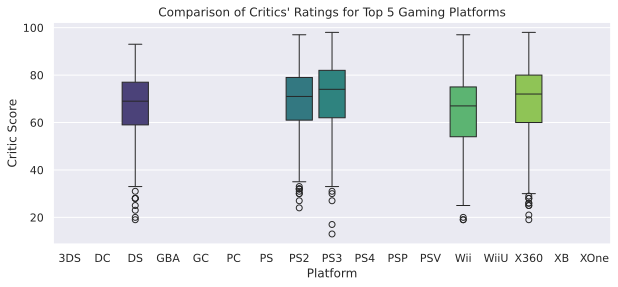

In [ ]:
top_platforms = df.groupby('Platform')['Global_Sales'].sum().nlargest(5).index
df_top_platforms = df[df['Platform'].isin(top_platforms)]
plt.figure(figsize=(10, 4))
sns.boxplot(x='Platform', y='Critic_Score', data=df_top_platforms, palette='viridis')
plt.title('Comparison of Critics\' Ratings for Top 5 Gaming Platforms')
plt.xlabel('Platform')
plt.ylabel('Critic Score')
plt.show()

### Your answer to Q2.6:
PS2 games consistently achieve the highest median critic scores, averaging around 75. X360 and PS3 both have comparable median scores, both hovering near 70. In contrast, DS games tend to garner slightly lower median scores around 65. The critic scores exhibit notable variability across all platforms, as evidenced by the spread illustrated in the box-and-whisker plots.

Breaking down the platforms:
- PS2: Commands the highest median score and displays a broader range of scores, including outliers reaching as high as 95.
- X360: Features a more concentrated distribution of scores ranging from 60-80, with instances of extreme outliers till 95.
- PS3: Exhibits a distribution similar to PS2 but with a slightly lower median.
- Wii: Features a more concentrated distribution of scores ranging from 50-70, with instances of extreme outliers like X360.
- DS: Holds the lowest median score and showcases a more focused spread of scores, with the majority falling within the 60 to 75 range.

But the overall critic-score range for all top 5 games between 60-70.



---

## Q2.7
1. Use heatmap to visualize the total sales of games by genre and gaming platform.

2. What can you tell from it?

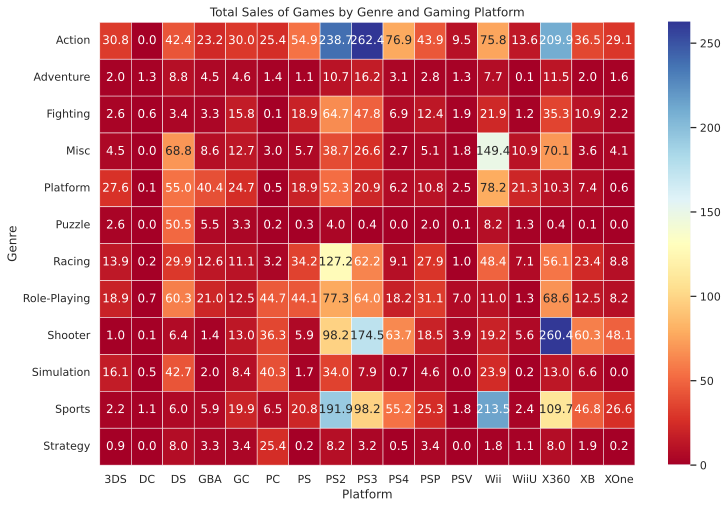

In [ ]:
heatmap_data = df.pivot_table(index='Genre', columns='Platform', values='Global_Sales', aggfunc='sum', fill_value=0)
plt.figure(figsize=(12, 8))
sns.heatmap(heatmap_data, cmap='RdYlBu', annot=True, fmt=".1f", linewidths=.5)

plt.title('Total Sales of Games by Genre and Gaming Platform')
plt.xlabel('Platform')
plt.ylabel('Genre')

plt.show()

### Your answer to Q2.7:
In this heatmap we can observe that:

Action games emerge as the most selling genre across diverse platforms on global level, with highest of 262.4million on PS3 and lowest at 0 million on DC platform.
Shooter games demonstrate strong sales on X360 at 260.4million and has earned on every platform.Robust sales are also evident for sports games, particularly on Wii of 213.5million and PS2 of 191.9 million, also has earned on every platform.
The miscellaneous category exhibits widespread popularity across platforms, with noteworthy sales on Wii of 149.4 million.
PS2 and PS3 consistently boasts the highest Global sales across various genres, except for Puzzle and Strategy. X360 stands out for notable sales in action, sports, shooter, and misc, while Wii excels in sports and misc game sales.